## Predicting Airbnb Listing Prices in Paris, Barcelona, and Vienna with Listing Characteristics

### STAT 301 Group 9 Final Project

In [1]:
# Load Packages
library(tidyverse)
library(broom)
library(leaps)
library(MASS)
library(rsample)

set.seed(999)

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.5.1     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.1
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors

Attaching package: ‘MASS’


The following object is masked from ‘package:dplyr’:

    select




In [2]:
# Load Data 
airbnb <- read_csv('airbnb.csv')
head(airbnb)

Rows: 13058 Columns: 21
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (3): room_type, city, day_type
dbl (15): realSum, person_capacity, multi, biz, cleanliness_rating, guest_sa...
lgl  (3): room_shared, room_private, host_is_superhost

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


realSum,room_type,room_shared,room_private,person_capacity,host_is_superhost,multi,biz,cleanliness_rating,guest_satisfaction_overall,⋯,dist,metro_dist,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,city,day_type
<dbl>,<chr>,<lgl>,<lgl>,<dbl>,<lgl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
474.3175,Entire home/apt,FALSE,FALSE,4,FALSE,0,1,10,91,⋯,1.111996,0.63049095,526.4694,17.94293,915.5871,20.15489,2.17556,41.39624,Barcelona,Weekday
169.8978,Private room,FALSE,TRUE,2,TRUE,1,0,10,88,⋯,1.751839,0.12401717,320.1275,10.91046,794.2774,17.48449,2.14906,41.38714,Barcelona,Weekday
161.9848,Private room,FALSE,TRUE,4,FALSE,0,1,9,88,⋯,1.670493,0.08032198,344.0739,11.72659,840.6736,18.50581,2.15357,41.37859,Barcelona,Weekday
367.9568,Entire home/apt,FALSE,FALSE,3,FALSE,0,1,10,91,⋯,1.475847,0.09310686,400.0574,13.63460,946.5899,20.83736,2.16839,41.37390,Barcelona,Weekday
196.8953,Private room,FALSE,TRUE,3,FALSE,1,0,9,91,⋯,1.855452,0.27248605,346.0422,11.79368,792.2960,17.44087,2.15238,41.37699,Barcelona,Weekday
330.9517,Entire home/apt,FALSE,FALSE,3,FALSE,0,1,9,100,⋯,2.565611,0.70129045,391.0874,13.32889,525.5139,11.56818,2.18197,41.40842,Barcelona,Weekday


## Data Cleaning

Before we begin our exploratory data analysis, we'll select the variables that we're interested in and convert logical data types to factor levels.

In [3]:
# Select Relevant Variables
airbnb_clean <- airbnb %>%
    dplyr::select(
        -room_shared,
        -room_private,
        -multi,
        -biz,
        -attr_index,
        -rest_index,
        -lng,
        -lat
    ) %>%
    mutate_if(is.logical, as.factor)
glimpse(airbnb_clean)

Rows: 13,058
Columns: 13
$ realSum                    <dbl> 474.3175, 169.8978, 161.9848, 367.9568, 196…
$ room_type                  <chr> "Entire home/apt", "Private room", "Private…
$ person_capacity            <dbl> 4, 2, 4, 3, 3, 3, 3, 2, 4, 2, 2, 2, 2, 2, 3…
$ host_is_superhost          <fct> FALSE, TRUE, FALSE, FALSE, FALSE, FALSE, FA…
$ cleanliness_rating         <dbl> 10, 10, 9, 10, 9, 9, 9, 9, 9, 9, 9, 10, 9, …
$ guest_satisfaction_overall <dbl> 91, 88, 88, 91, 91, 100, 86, 96, 84, 91, 84…
$ bedrooms                   <dbl> 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1…
$ dist                       <dbl> 1.1119965, 1.7518390, 1.6704929, 1.4758465,…
$ metro_dist                 <dbl> 0.63049095, 0.12401717, 0.08032198, 0.09310…
$ attr_index_norm            <dbl> 17.942927, 10.910462, 11.726595, 13.634603,…
$ rest_index_norm            <dbl> 20.15489, 17.48449, 18.50581, 20.83736, 17.…
$ city                       <chr> "Barcelona", "Barcelona", "Barcelona", "Bar…
$ day_type     

In [4]:
# Check for Missing Data
n_missing <- sum(is.na(airbnb_clean))

cat("There are", n_missing, "missing values.")

There are 0 missing values.

Since there is no missing data, and the data is in a tidy format, we can move on to the exploratory data analysis.

## Exploratory Data Analysis

First, we'll explore the distribution of the response variable, 'realSum' and its summary statistics.

    realSum        
 Min.   :   63.58  
 1st Qu.:  187.93  
 Median :  260.74  
 Mean   :  330.21  
 3rd Qu.:  380.29  
 Max.   :16445.62  

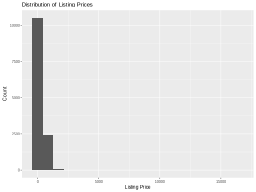

In [5]:
# Main developer: Matthew

# Plot Price Distribution
options(repr.plot.width = 8, repr.plot.height = 6, repr.plot.res = 32)

airbnb_price_plot <- airbnb_clean %>%
    ggplot(aes(realSum)) + 
    geom_histogram(bins = 20) + 
    xlab('Listing Price') +
    ylab('Count') +
    ggtitle('Distribution of Listing Prices')

price_summary <- airbnb_clean %>%
    dplyr::select(realSum) %>%
    summary()

airbnb_price_plot
price_summary

Note the strong rightward skew of the data.  The summary statistics tell us that 50% of the listing prices are between $187.93$ and $380.29$, while the max is $16445.62$.  To improve clarity in our visualizations, we'll continue with the EDA using the log-transformed price.

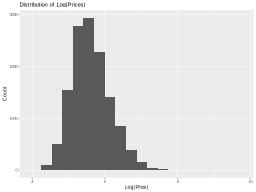

In [6]:
# Main developer: Matthew

# Convert to Log Prices for EDA
airbnb_eda <- airbnb_clean %>%
    mutate(logSum = log(realSum)) %>%
    dplyr::select(-realSum)

# Plot Log Price Distribution
airbnb_logPrice_plot <- airbnb_eda %>%
    ggplot(aes(logSum)) + 
    geom_histogram(bins = 20) + 
    xlab('Log(Price)') +
    ylab('Count') +
    ggtitle('Distribution of Log(Prices)')

airbnb_logPrice_plot

In [7]:
# Specify Numerical & Categorical Predictors
num_predictors <- c(
    'person_capacity', 
    'cleanliness_rating',
    'guest_satisfaction_overall',
    'bedrooms',
    'dist',
    'metro_dist',
    'attr_index_norm',
    'rest_index_norm'
)

cat_predictors <- c(
    'room_type',
    'host_is_superhost',
    'city',
    'day_type'
)

### Numerical Predictors

First, we'll take a look at the relationships between the numerical predictors and the response. Due to the large size of the dataset, we'll plot a random sample using just over half the data to ease computation.

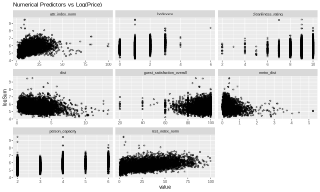

In [8]:
# Main developer: Matthew

# Plot Numerical Predictors & Log(Price)
options(repr.plot.width = 10, repr.plot.height = 6, repr.plot.res = 32)

airbnb_num_long <- airbnb_eda %>%
    dplyr::select(logSum, all_of(num_predictors)) %>%
    sample_n(6600) %>%
    pivot_longer(cols = -logSum, names_to = "predictor", values_to = "value")

numerical_plots <- airbnb_num_long %>%
    ggplot(aes(x = value, y = logSum)) +
    geom_point(alpha = 0.4) +
    ggtitle("Numerical Predictors vs Log(Price)") +
    facet_wrap( ~ predictor, scales = "free_x")

numerical_plots

Based on the plots of each numerical variable, we can see that:

- `attr_index_norm`, `bedrooms`, and `rest_index_norm` have a positive relationship with price
- `dist` and `metro_dist` have a negative relationship with price
- `cleanliness_rating` and `guest_satisfaction_overall` show no clear relationship with price

We should also explore possibilities of multicollinearity between our numerical predictors. We can visualize this with a correlation heat map using the absolute values of each pairwise correlation coefficients. We can also filter for the pairs with notably high correlation coefficients.

var1,var2,abs_corr
<chr>,<chr>,<dbl>
cleanliness_rating,guest_satisfaction_overall,0.67
bedrooms,person_capacity,0.53
attr_index_norm,dist,0.51
attr_index_norm,rest_index_norm,0.71


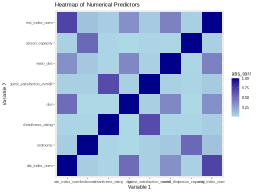

In [9]:
# Main developer: Matthew

options(repr.plot.width = 8, repr.plot.height = 6, repr.plot.res = 32)

# Correlation Table (Absolute Values)
abs_corr_table <- airbnb_eda %>%
    dplyr::select(all_of(num_predictors)) %>%
    cor() %>%
    round(2) %>%
    as.data.frame() %>%
    mutate_all(abs)

# Heat Map
num_heatmap <- abs_corr_table %>%
    rownames_to_column(var = "var1") %>%
    pivot_longer(-var1, names_to = "var2", values_to = "abs_corr") %>%
    ggplot(aes(x = var1, y = var2, fill = abs_corr)) + 
        geom_tile() +
        scale_fill_gradient(low = 'lightblue', high = 'darkblue') +
        labs(
            title = 'Heatmap of Numerical Predictors',
            x = 'Variable 1',
            y = 'Variable 2'
        )

# High Correlation Coefficients (Absolute Values)
high_corr <- abs_corr_table %>%
    rownames_to_column(var = "var1") %>%
    pivot_longer(-var1, names_to = "var2", values_to = "abs_corr") %>%
    filter(var1 < var2) %>%
    filter(abs_corr > 0.5)

high_corr
num_heatmap

From the correlation coefficients and the heat map, we gather that:

* The following pairs are notably correlated and could contribute to multicollinearity:
    * `bedrooms` & `person_capacity`
    * `attr_index_norm` & `dist`
* The following pairs are highly correlated and suggest a high risk of multicollinearity:
    * `cleanliness_rating` & `guest_satisfaction_overall`
    * `attr_index_norm` & `rest_index_norm`

### Categorical Predictors

Next, we'll take a look at boxplots and summary statistics to explore the relationships between our categorical variables and the response.

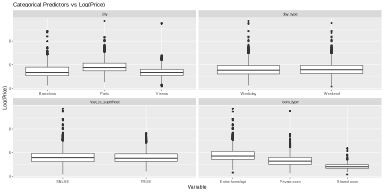

In [10]:
# Main developer: Matthew

# Plot Categorical Predictors
options(repr.plot.width = 12, repr.plot.height = 6, repr.plot.res = 32)

airbnb_cat_long <- airbnb_eda %>%
    dplyr::select(logSum, all_of(cat_predictors)) %>%
    pivot_longer(cols = -logSum, names_to = "predictor", values_to = "value")

categorical_plots <- airbnb_cat_long %>%
    ggplot(aes(x = value, y = logSum)) +
    geom_boxplot() +
    ggtitle("Categorical Predictors vs Log(Price)") +
    xlab("Variable") +
    ylab("Log(Price)") +
    facet_wrap( ~ predictor, scales = "free_x")

categorical_plots

From the boxplots, we can see that:

* Price differs by city, with the median log-prices notably highest in Paris, and lowest in Vienna.
* Price differs by room type, with the median log-prices notably highest for Entire home/apt listings and lowest for shared room listings.
* Price differs slightly for superhosts, as superhosts have slightly higher median log-prices.
* Price shows little difference between weekdays and weekends.

In [11]:
# Summary Tables
airbnb_roomType_counts <- airbnb_eda %>%
    dplyr::select(room_type, logSum) %>%
    group_by(room_type) %>%
    summarize(
        count = n(),
        mean = mean(logSum),
        median = median(logSum)
    )

airbnb_city_counts <- airbnb_eda %>%
    dplyr::select(city, logSum) %>%
    group_by(city) %>%
    summarize(
        count = n(),
        mean = mean(logSum),
        median = median(logSum)
    )

airbnb_superhost_counts <- airbnb_eda %>%
    dplyr::select(host_is_superhost, logSum) %>%
    group_by(host_is_superhost) %>%
    summarize(
        count = n(),
        mean = mean(logSum),
        median = median(logSum)
    )

airbnb_dayType_counts <- airbnb_eda %>%
    dplyr::select(day_type, logSum) %>%
    group_by(day_type) %>%
    summarize(
        count = n(),
        mean = mean(logSum),
        median = median(logSum)
    )


airbnb_superhost_counts
airbnb_roomType_counts
airbnb_city_counts
airbnb_dayType_counts

host_is_superhost,count,mean,median
<fct>,<int>,<dbl>,<dbl>
FALSE,10598,5.623423,5.573756
TRUE,2460,5.607808,5.522045


room_type,count,mean,median
<chr>,<int>,<dbl>,<dbl>
Entire home/apt,8356,5.788874,5.709617
Private room,4580,5.332374,5.276742
Shared room,122,4.902804,4.804832


city,count,mean,median
<chr>,<int>,<dbl>,<dbl>
Barcelona,2833,5.470405,5.338976
Paris,6688,5.822399,5.760784
Vienna,3537,5.358887,5.339910


day_type,count,mean,median
<chr>,<int>,<dbl>,<dbl>
Weekday,6423,5.608572,5.540022
Weekend,6635,5.632011,5.577728


The summary statistics reinforce our findings from the boxplots, but we should note that some factor levels are quite sparse:

* `room_type`: shared rooms make up just under 0.01% of the listings
* `host_is_superhost`: Superhost listings account for around 19% of the listings

## Model Selection

Before we begin our model selection, we'll split the data into subsets for training and testing the model.

In [12]:
# Train/Test Split
split <- initial_split(airbnb_clean, prop = 0.75)

airbnb_train <- training(split)
airbnb_test <- testing(split)

Since we are considering only 12 variables, we can explore both forward and backward selection methods, comparing models using the adjusted R-squared metric.

In [13]:
# Forward & Backward Selection
airbnb_for_selection <- regsubsets(realSum ~ ., nvmax = 12, data = airbnb_train, method = 'forward')
airbnb_back_selection <- regsubsets(realSum ~ ., nvmax = 12, data = airbnb_train, method = 'backward')

airbnb_for_selection_summary <- summary(airbnb_for_selection)
airbnb_back_selection_summary <- summary(airbnb_back_selection)

# airbnb_for_selection_summary

In [14]:
# Model Evaluation for Forward Selection
airbnb_for_selection_summary_df <- tibble(
    n_input_variables = 1:12,
    RSQ = airbnb_for_selection_summary$rsq,
    RSS = airbnb_for_selection_summary$rss,
    ADJ_R2 = airbnb_for_selection_summary$adjr2,
    Cp = airbnb_for_selection_summary$cp,
    BIC = airbnb_for_selection_summary$bic,
)

# Selected Variables
for_adjr2_max = which.max(airbnb_for_selection_summary$adjr2)
for_selected_var_adjr2 <- names(coef(airbnb_for_selection, for_adjr2_max))[-1]

for_selected_var_adjr2

[1] "room_typePrivate room" "room_typeShared room"  "person_capacity"      
 [4] "cleanliness_rating"    "bedrooms"              "dist"                 
 [7] "metro_dist"            "attr_index_norm"       "rest_index_norm"      
[10] "cityVienna"            "day_typeWeekend"

In [15]:
# Model Evaluation for Backward Selection 
airbnb_back_selection_summary_df <- tibble(
    n_input_variables = 1:12,
    RSQ = airbnb_back_selection_summary$rsq,
    RSS = airbnb_back_selection_summary$rss,
    ADJ_R2 = airbnb_back_selection_summary$adjr2,
    Cp = airbnb_back_selection_summary$cp,
    BIC = airbnb_back_selection_summary$bic,
)

# Selected Variables
back_adjr2_max = which.max(airbnb_back_selection_summary$adjr2)
back_selected_var_adjr2 <- names(coef(airbnb_back_selection, back_adjr2_max))[-1]

back_selected_var_adjr2

[1] "room_typePrivate room" "room_typeShared room"  "person_capacity"      
 [4] "cleanliness_rating"    "bedrooms"              "dist"                 
 [7] "metro_dist"            "attr_index_norm"       "rest_index_norm"      
[10] "cityVienna"            "day_typeWeekend"

Both the forward and backward selection algorithms selected the same 10 variables.

In [16]:
# Main developer: Matthew

# Selected Predictive Model
airbnb_mlr_predictor <- lm(
    realSum ~ 
        room_type + 
        person_capacity + 
        cleanliness_rating + 
        bedrooms + 
        dist +
        metro_dist + 
        attr_index_norm + 
        rest_index_norm + 
        city + 
        day_type, 
    data = airbnb_train
)

tidy(airbnb_mlr_predictor)

term,estimate,std.error,statistic,p.value
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
(Intercept),-131.490195,41.1147527,-3.1981269,1.387641e-03
room_typePrivate room,-89.385406,9.8047112,-9.1165772,9.280586e-20
room_typeShared room,-236.993042,38.9633682,-6.0824578,1.227865e-09
person_capacity,42.758407,3.9461516,10.8354699,3.335580e-27
cleanliness_rating,13.307467,3.8001142,3.5018597,4.640846e-04
bedrooms,105.781093,7.3260457,14.4390436,8.882886e-47
dist,7.703696,3.2871156,2.3436035,1.911838e-02
metro_dist,-21.660419,13.2650983,-1.6328879,1.025248e-01
attr_index_norm,4.801466,0.7054782,6.8059735,1.062571e-11
